# Topic 8 - Assignment EDA in Python

### Assessment Description
This assignment requires a certain amount of research and initiative, as not all tasks and subtasks are fully defined. You are expected to employ critical and creative thinking skills to complete this assignment in a comprehensive manner.

Tasks:
1.	Refer to the assigned readings for examples on how to approach EDA in a professional manner.

the better you know the dataset, the better the analysis will be

objective of EDA:

Confirm that the data makes sense in context being used in the data analysis 
for the hypothesis test that is trying to be solved. 

In this case, the data set selected from Kaggle Life Expectancy (WHO) it has 22 columns and 2938 rows.

The columns are 

Country: 
that the data is from 193 countries in this data set

Year: 
the study was made, 

Status: 
if the country is developed or developing 

Life_expectancy: 
is the years the population age life expectancy and this is the main focus of the data to get know what makes each country life expectancy differ from each other

Adult_Mortality: 
Rates of both sexes (probability of dying between 15 and 60 years per 1000 population)

infant_deaths: 
Number of Infant Deaths per 1000 population

Alcohol: 
recorded per capita (15+) consumption (in liters of pure alcohol)

percentage_expenditure: 
Expenditure on health as a percentage of Gross Domestic Product per capita(%)

Hepatitis_B:
(HepB) immunization coverage among 1-year-olds (%)	

Measles:
number of reported cases per 1000 population	

BMI: 
Average Body Mass Index of the entire population

under-five_deaths:
Number of under-five deaths per 1000 population

Polio: 
(Pol3) immunization coverage among 1-year-olds (%)

Total expenditure:
General government expenditure on health as a percentage of total government expenditure (%)

Diphtheria:
Diphtheria tetanus toxoid and pertussis (DTP3) immunization coverage among 1-year-olds (%)

HIV/AIDS:
Deaths per 1 000 live births HIV/AIDS (0-4 years)

GDP:
Gross Domestic Product per capita (in USD)

Population:
Population of the country

thinness 1-19 years:
Prevalence of thinness among children and adolescents from Age 10 to 19 (%)

thinness 5-9 years:
Prevalence of thinness among children from Age 5 to 9(%)

Income composition of resources:
Human Development Index in terms of income composition of resources (index ranging from 0 to 1)

Schooling:
Number of years of Schooling(years)

the number of countries is 193, and the rows are 2938. Per each country from the year 2000 to 2015

By knowing information about the variable, we can better understand the data set information. Based on the Life Expectancy (WHO) information in kaggle this data set was collected from credible sources from The Global Health Observatory data repository under World Health Organization (WHO). This data was collected from 2000 to 2015, this data set was cleaned from missing data with R software but still contains missing data NaN, blank spaces that will need to be handled to be able to perform the predicting test and methods.

reference:

Jarshi, K(2017). Life Expectancy(WHO)[kaggle]
https://www.kaggle.com/datasets/kumarajarshi/life-expectancy-who/data

Adivarekar, S., Nanwani, S., Mandal, N. and Sarode,T. (2023) "Implementation of Exploratory Data Analysis on Weather Data," 2023 International Conference on Communication System, Computing and IT Applications (CSCITA), (Mumbai, India), (pp. 21-25), doi: 10.1109/CSCITA55725.2023.10104864.

2.	Select a dataset from a reputable source (e.g., from Kaggle, UCI Machine Learning Repository) from the list of "Repositories for Finding Suitable Datasets," located in Class Resources, that is suitable for exploratory data analysis. The dataset should have at least 10 variables and 1,000 rows.

Jarshi, K(2017). Life Expectancy(WHO)[kaggle]
https://www.kaggle.com/datasets/kumarajarshi/life-expectancy-who/data

The CSV file is Life_expectancy_data.csv and contains 22 variables and 2938 rows. Above explained the data set variables the next steps for conduct the EDA is to import the required libraries that will be used in this data analysis.

In [348]:
#Libraries that will be used in this data analysis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import f_oneway
from scipy.stats import pearsonr
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
import scipy.stats as stats

In [349]:
#step 1: Import data 
df = pd.read_csv('Life_expectancy_data.csv')

In [350]:
#step 2: printing dataset 
df

,Country,Year,Status,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,percentage_expenditure,Hepatitis_B,Measles,...,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [351]:
print(df.head())

       Country  Year      Status  Life_expectancy  Adult_Mortality  \
0  Afghanistan  2015  Developing             65.0            263.0   
1  Afghanistan  2014  Developing             59.9            271.0   
2  Afghanistan  2013  Developing             59.9            268.0   
3  Afghanistan  2012  Developing             59.5            272.0   
4  Afghanistan  2011  Developing             59.2            275.0   

   infant_deaths  Alcohol  percentage_expenditure  Hepatitis_B  Measles  ...  \
0             62     0.01               71.279624         65.0     1154  ...   
1             64     0.01               73.523582         62.0      492  ...   
2             66     0.01               73.219243         64.0      430  ...   
3             69     0.01               78.184215         67.0     2787  ...   
4             71     0.01                7.097109         68.0     3013  ...   

   Polio  Total_expenditure  Diphtheria  HIV/AIDS         GDP  Population  \
0    6.0             

Jupyter already has print method integrated and print() is optional to get the output

In [352]:
df.head()

,Country,Year,Status,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,percentage_expenditure,Hepatitis_B,Measles,...,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


printing data in jupyter without print() looks better and is more user friendly to see data 

In [353]:
# Convert "Status" column to numeric values (Developed: 1, Developing: 0)
df['Status'] = df['Status'].map({'Developed': 1, 'Developing': 0})

3.	Conduct exploratory data analysis on the selected dataset using Python libraries (e.g.,  Pandas, Matplotlib, Seaborn). The analysis should include data cleaning, summary statistics, and visualizations to understand the data distribution and patterns.

In [354]:
#step 3: data cleaning 
# Check for missing values
print(df.isnull().sum())

#can be done in different way but to handle the missing values will drop the rows with missing values because the mean value to replace in the missing data for alot of missing data is better to trim this data to have better results
df.dropna(inplace=True)

Country                              0
Year                                 0
Status                               0
Life_expectancy                     10
Adult_Mortality                     10
infant_deaths                        0
Alcohol                            194
percentage_expenditure               0
Hepatitis_B                        553
Measles                              0
BMI                                 34
under-five_deaths                    0
Polio                               19
Total_expenditure                  226
Diphtheria                          19
HIV/AIDS                             0
GDP                                448
Population                         652
thinness_1-19_years                 34
thinness_5-9_years                  34
Income_composition_of_resources    167
Schooling                          163
dtype: int64


In [355]:
df

,Country,Year,Status,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,percentage_expenditure,Hepatitis_B,Measles,...,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,0,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,0,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,0,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,0,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,0,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,0,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,0,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,0,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,0,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


This new data set with cleaning made trimmed the missing data rows and from 2938 rows it ended with 1649 rows 

In [356]:
# Check for missing values after cleaning missing data 
print(df.isnull().sum())

Country                            0
Year                               0
Status                             0
Life_expectancy                    0
Adult_Mortality                    0
infant_deaths                      0
Alcohol                            0
percentage_expenditure             0
Hepatitis_B                        0
Measles                            0
BMI                                0
under-five_deaths                  0
Polio                              0
Total_expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
thinness_1-19_years                0
thinness_5-9_years                 0
Income_composition_of_resources    0
Schooling                          0
dtype: int64


In [357]:
#Step 4: Summary statistics
df.describe()

,Year,Status,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,percentage_expenditure,Hepatitis_B,Measles,BMI,...,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
count,1649.000000,1649.000000,1649.000000,1649.000000,1649.000000,1649.000000,1649.000000,1649.000000,1649.000000,1649.000000,...,1649.000000,1649.000000,1649.000000,1649.000000,1649.000000,1.649000e+03,1649.000000,1649.000000,1649.000000,1649.000000
mean,2007.840509,0.146756,69.302304,168.215282,32.553062,4.533196,698.973558,79.217708,2224.494239,38.128623,...,83.564585,5.955925,84.155246,1.983869,5566.031887,1.465363e+07,4.850637,4.907762,0.631551,12.119891
std,4.087711,0.353969,8.796834,125.310417,120.847190,4.029189,1759.229336,25.604664,10085.802019,19.754249,...,22.450557,2.299385,21.579193,6.032360,11475.900117,7.046039e+07,4.599228,4.653757,0.183089,2.795388
min,2000.000000,0.000000,44.000000,1.000000,0.000000,0.010000,0.000000,2.000000,0.000000,2.000000,...,3.000000,0.740000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,4.200000
25%,2005.000000,0.000000,64.400000,77.000000,1.000000,0.810000,37.438577,74.000000,0.000000,19.500000,...,81.000000,4.410000,82.000000,0.100000,462.149650,1.918970e+05,1.600000,1.700000,0.509000,10.300000
50%,2008.000000,0.000000,71.700000,148.000000,3.000000,3.790000,145.102253,89.000000,15.000000,43.700000,...,93.000000,5.840000,92.000000,0.100000,1592.572182,1.419631e+06,3.000000,3.200000,0.673000,12.300000
75%,2011.000000,0.000000,75.000000,227.000000,22.000000,7.340000,509.389994,96.000000,373.000000,55.800000,...,97.000000,7.470000,97.000000,0.700000,4718.512910,7.658972e+06,7.100000,7.100000,0.751000,14.000000
max,2015.000000,1.000000,89.000000,723.000000,1600.000000,17.870000,18961.348600,99.000000,131441.000000,77.100000,...,99.000000,14.390000,99.000000,50.600000,119172.741800,1.293859e+09,27.200000,28.200000,0.936000,20.700000


getting statistical values for this data set but is the overall data for the entire world life expectancy and the other variables

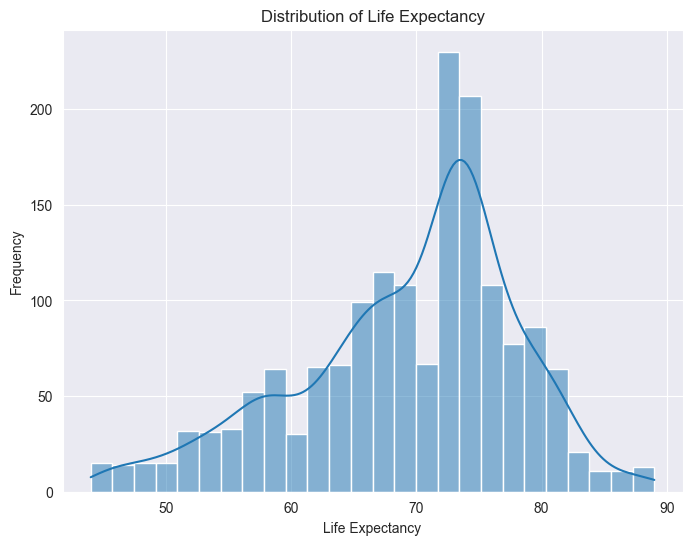

In [358]:
#step 5: understand basic data with data visualization and to get the data variables that we want to use to get the best output for life expectancy
#To create this data visualization we use Matplotlib and Seaborn 
# Histogram of Life_expectancy
plt.figure(figsize=(8, 6))
sns.histplot(df['Life_expectancy'], kde=True)
plt.title('Distribution of Life Expectancy')
plt.xlabel('Life Expectancy')
plt.ylabel('Frequency')
plt.show()


The life expectancy from the entire world countries is the frequency of how many countries have similar life expectancy from the range of ages that the data set has 

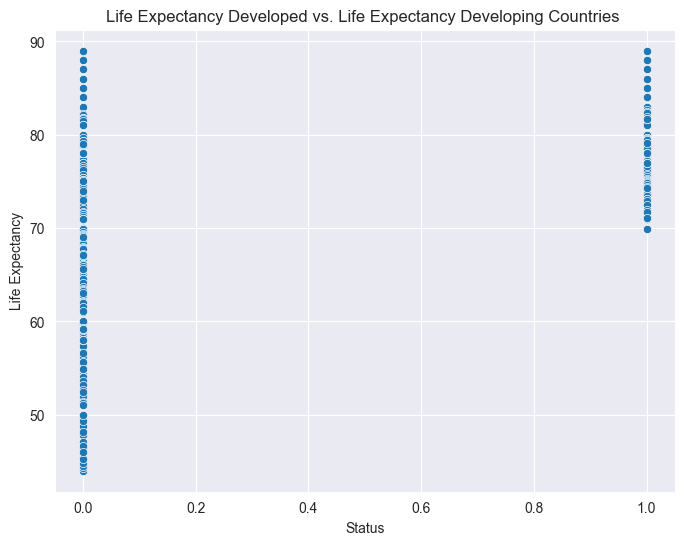

In [359]:
# Scatter plot: Life Expectancy Developed vs. Life Expectancy Developing Countries
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df, x='Status', y='Life_expectancy')
plt.title('Life Expectancy Developed vs. Life Expectancy Developing Countries ')
plt.xlabel('Status')
plt.ylabel('Life Expectancy')
plt.show()

Decided to do this scatter plot for Status vs Life expectancy.
The status has to categorize Developed and developing countries wanted to see the difference of age range of life expectancy and Developed countries have greater life expectancy.

In [360]:
developed = df[df.Status == 1]

In [361]:
developed

,Country,Year,Status,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,percentage_expenditure,Hepatitis_B,Measles,...,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
113,Australia,2014,1,82.7,6.0,1,9.71,10769.363050,91.0,340,...,92.0,9.42,92.0,0.1,62214.69120,2346694.0,0.6,0.6,0.936,20.4
114,Australia,2013,1,82.5,61.0,1,9.87,11734.853810,91.0,158,...,91.0,9.36,91.0,0.1,67792.33860,23117353.0,0.6,0.6,0.933,20.3
115,Australia,2012,1,82.3,61.0,1,10.03,11714.998580,91.0,199,...,92.0,9.36,92.0,0.1,67677.63477,22728254.0,0.6,0.6,0.930,20.1
116,Australia,2011,1,82.0,63.0,1,10.30,10986.265270,92.0,190,...,92.0,9.20,92.0,0.1,62245.12900,223424.0,0.6,0.6,0.927,19.8
117,Australia,2010,1,81.9,64.0,1,10.52,8875.786493,92.0,70,...,92.0,9.20,92.0,0.1,51874.84800,223175.0,0.7,0.6,0.927,19.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2440,Spain,2000,1,79.1,86.0,2,11.12,1934.398154,77.0,152,...,95.0,7.21,95.0,0.1,14676.76900,4567864.0,0.6,0.5,0.820,15.7
2506,Sweden,2014,1,82.3,54.0,0,7.30,1142.212403,67.0,26,...,98.0,11.93,98.0,0.1,5918.19898,969611.0,1.5,1.3,0.906,15.8
2507,Sweden,2013,1,81.9,57.0,0,7.30,1212.666327,67.0,51,...,98.0,11.97,98.0,0.1,6283.24522,96379.0,1.4,1.3,0.904,15.8
2508,Sweden,2012,1,81.7,57.0,0,7.40,10947.023270,53.0,30,...,98.0,11.80,98.0,0.1,57134.77700,9519374.0,1.4,1.3,0.903,15.8


In [362]:
developed.Life_expectancy.mean()

78.69173553719008

In [363]:
developing= df[df.Status == 0]

In [364]:
developing

,Country,Year,Status,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,percentage_expenditure,Hepatitis_B,Measles,...,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,0,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,0,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,0,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,0,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,0,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,0,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,0,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,0,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,0,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [365]:
developing.Life_expectancy.mean()

67.68734896943853

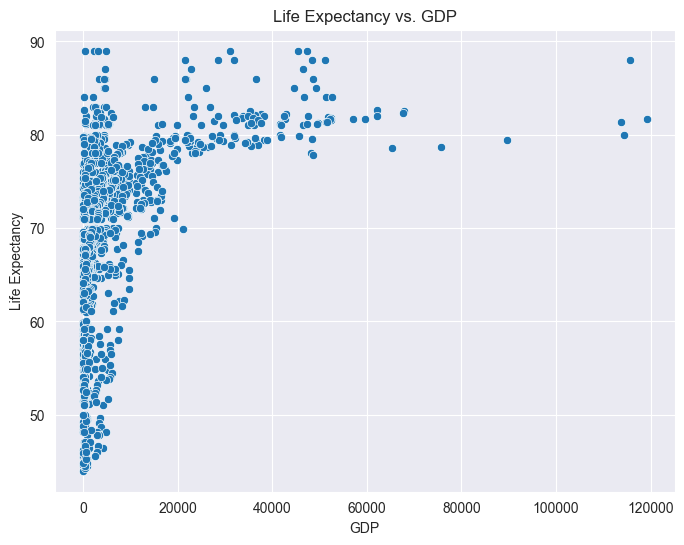

In [366]:
# Scatter plot: Life Expectancy vs. GDP
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df, x='GDP', y='Life_expectancy')
plt.title('Life Expectancy vs. GDP')
plt.xlabel('GDP')
plt.ylabel('Life Expectancy')
plt.show()

The next scatter plot is GDP vs Life expectancy
GDP is Gross Domestic Product per capita (in USD in this data set)

The Brief definition for GDP is the monetary value of final goods and services 
It is good to indicate how much economical a country produces per year

This scatter plot is not linear, and the country's GDP can be low and the life expectancy can range from high to low life expectancy not many countries have a high gpd those can be considered Outliers.

Reference:
Callen, Tim(Nan) Gross Domestic Product: An Economy's All,[website]
https://www.imf.org/en/Publications/fandd/issues/Series/Back-to-Basics/gross-domestic-product-GDP#:~:text=GDP%20measures%20the%20monetary%20value,a%20quarter%20or%20a%20year).

In [367]:
# Step 6 get the correlation between the variables to explore the relationship they have with each other.

# Correlation matrix for the data set df and need to be numeric values only if not there will be error given that corr() could not conver string to float
correlation_matrix = df.corr(numeric_only=True)


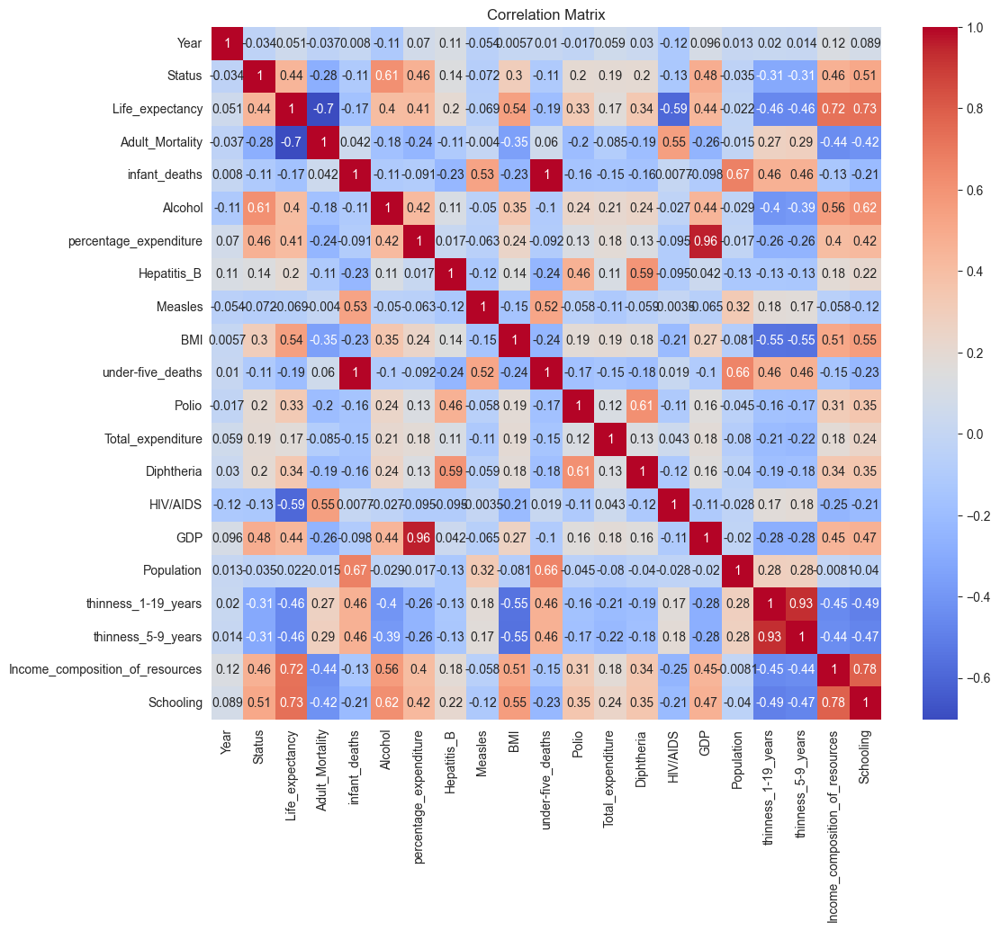

In [368]:
# Heatmap of correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

Status was not added in this correlation heatmap becauses it is a string but will add it by converting developed == 1 and developing == 0 

In [368]:
# Convert "Status" column to numeric values (Developed: 1, Developing: 0)
df['Status'] = df['Status'].map({'Developed': 1, 'Developing': 0})

In [369]:
df['Status']

0       0
1       0
2       0
3       0
4       0
       ..
2933    0
2934    0
2935    0
2936    0
2937    0
Name: Status, Length: 1649, dtype: int64

In [370]:
correlation_matrix_new = df.corr(numeric_only=True)

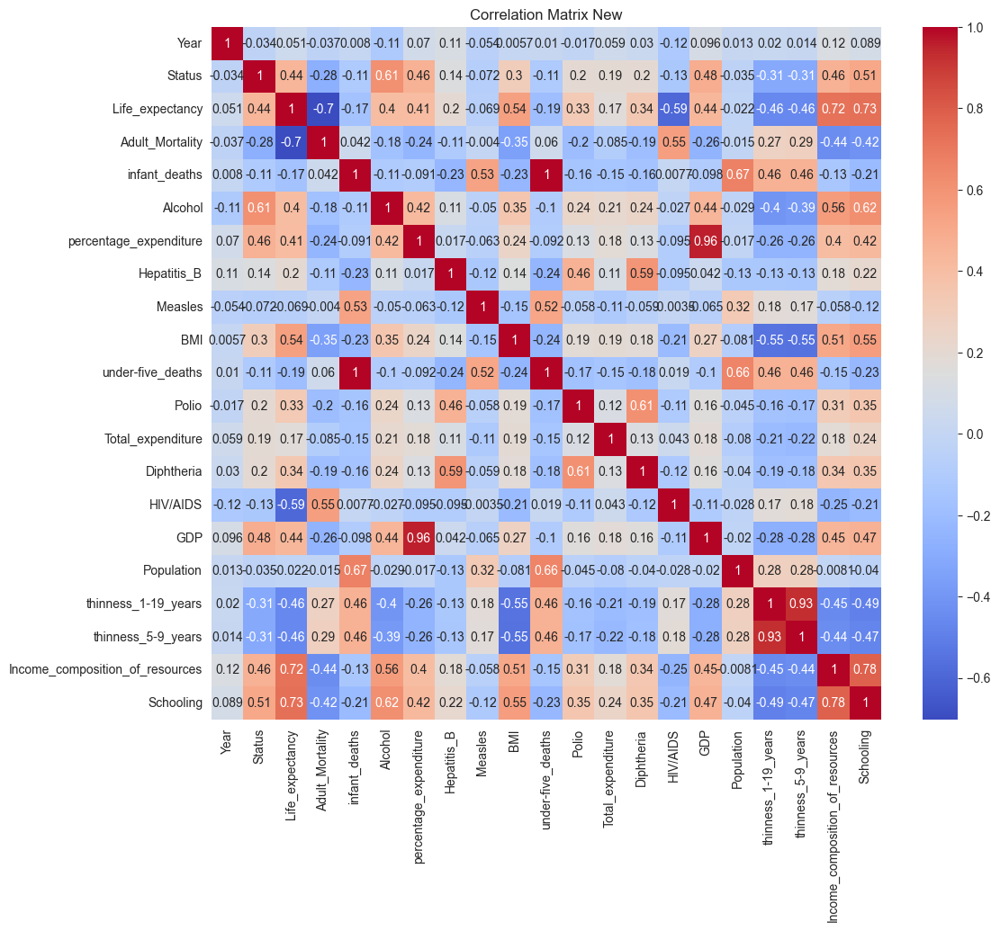

In [371]:
# Heatmap of correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix_new, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix New')
plt.show()

this correlation heatmap is better with Status added to it to get the correlation coefficient there are some high coefficient between variables that show good relationship. But the main focus is the life expectancy has good correlation with the other variables. Will be using the Life_expectancy variable as the dependent variable and the other variables as independent.

4.	Identify potential research questions or hypotheses that could be addressed through this analysis, and conduct correlation analysis to explore the relationships between variables. Use appropriate statistical techniques to measure the strength and direction of the relationship.

Based on the data set selected, the main focus is the life expectancy per country, and there are some main variables that have strength and direction shown in the Correlation analysis shown above. The variables that have better correlation coefficients are Life_expectancy, Schooling, Income_composition_of_resources, Status. 

Research question: Is there a strong relationship between Life_expectancy and Income_composition_of_resources?
Hypothesis: Higher Income_composition_of_resources is positively correlated with higher Life_expectancy.

This question was thought after the correlation analysis was created, and to interpret this correlation relationship between Life_expectancy and Income_composition_of_resources is 0.72 this demonstrates a positive correlation coefficient close to +1 and indicates a strong positive relationship. Hypothetically, if one variable, the other variable tends to increase as well. We can consider Life_expectancy as the dependent variable.


Hypothesis test:

The null H0 there is no correlation between Life_expectancy and Income_composition_of_resources.
hypothesis (H1) states that there is a correlation between these variables.

In [372]:
# Extract the relevant columns
life_expectancy = df['Life_expectancy']
income_composition = df['Income_composition_of_resources']

In [373]:
# Calculate the Pearson correlation coefficient and p-value
#The Pearson correlation test, measures the strength and direction of the linear relationship between two continuous variables.
# wanted to do the t-test, but that test is to compare to two variables means
correlation_coefficient, p_value = stats.pearsonr(life_expectancy, income_composition)

In [374]:
print(correlation_coefficient)
print(p_value)

0.7210825929172884
9.272180662005528e-265


In [375]:
# Set the significance level
alpha = 0.05

In [376]:
# Compare the p-value to the significance level
if p_value < alpha:
    print("There is a significant correlation between Life_expectancy and Income_composition_of_resources.")
else:
    print("There is no significant correlation between Life_expectancy and Income_composition_of_resources.")

There is a significant correlation between Life_expectancy and Income_composition_of_resources.


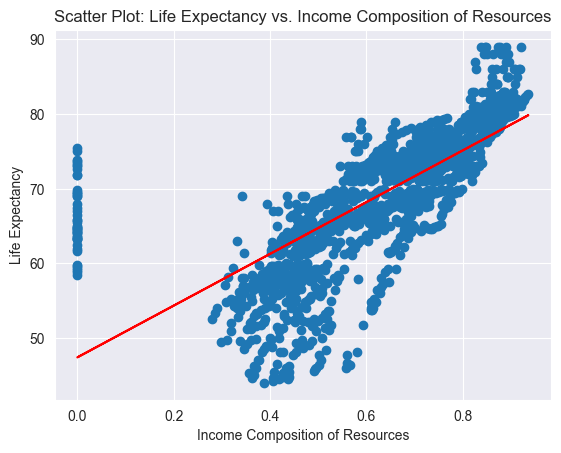

In [377]:
# Create a scatter plot
plt.scatter(income_composition, life_expectancy)
plt.xlabel('Income Composition of Resources')
plt.ylabel('Life Expectancy')
plt.title('Scatter Plot: Life Expectancy vs. Income Composition of Resources')
# Add a trendline
slope, intercept, _, _, _ = stats.linregress(income_composition, life_expectancy)
plt.plot(income_composition, slope * income_composition + intercept, color='red')

# Display the plot
plt.show()

Outliers' removal repeating the process to check the difference

 Winsorization replaces extreme values with less extreme ones, essentially "trimming" the dataset.

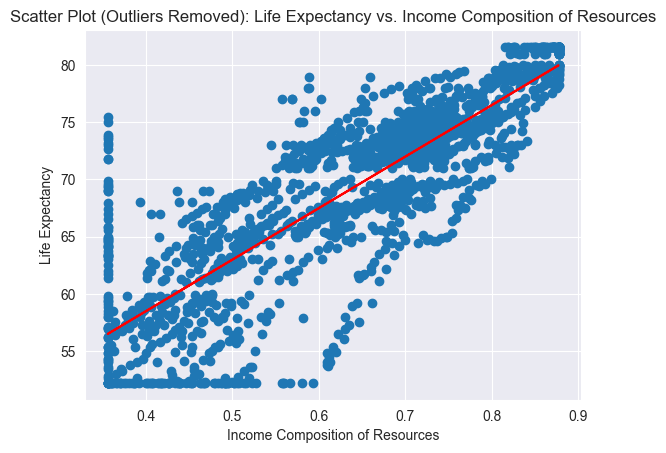

There is a significant correlation between Life_expectancy and Income_composition_of_resources (outliers removed).


In [378]:
# Winsorize the data (trim the extreme values)
life_expectancy_winsorized = stats.mstats.winsorize(life_expectancy, limits=[0.05, 0.05])
income_composition_winsorized = stats.mstats.winsorize(income_composition, limits=[0.05, 0.05])

# this data is use then for the correlation coefficient 

# Calculate the Pearson correlation coefficient and p-value
correlation_coefficient, p_value = stats.pearsonr(life_expectancy_winsorized, income_composition_winsorized)

# Set the significance level
alpha = 0.05

# Create a scatter plot of the winsorized data(removed outliers)
plt.scatter(income_composition_winsorized, life_expectancy_winsorized)
plt.xlabel('Income Composition of Resources')
plt.ylabel('Life Expectancy')
plt.title('Scatter Plot (Outliers Removed): Life Expectancy vs. Income Composition of Resources')

# Add a trendline
slope, intercept, _, _, _ = stats.linregress(income_composition_winsorized, life_expectancy_winsorized)
plt.plot(income_composition_winsorized, slope * income_composition_winsorized + intercept, color='red')

# Display the plot
plt.show()

# Compare the p-value to the significance level
if p_value < alpha:
    print("There is a significant correlation between Life_expectancy and Income_composition_of_resources (outliers removed).")
else:
    print("There is no significant correlation between Life_expectancy and Income_composition_of_resources (outliers removed).")

5.	Fit a regression model to investigate the relationship between two or more variables in the dataset. Use appropriate techniques to validate the assumptions of the regression model, such as normality, linearity, and homoscedasticity.

# Linear Regression

In [379]:
# Prepare the data for regression modeling
X = sm.add_constant(df[['GDP', 'Schooling', 'Status']])
y = df['Life_expectancy']

In [380]:
X

,const,GDP,Schooling,Status
0,1.0,584.259210,10.1,0
1,1.0,612.696514,10.0,0
2,1.0,631.744976,9.9,0
3,1.0,669.959000,9.8,0
4,1.0,63.537231,9.5,0
...,...,...,...,...
2933,1.0,454.366654,9.2,0
2934,1.0,453.351155,9.5,0
2935,1.0,57.348340,10.0,0
2936,1.0,548.587312,9.8,0


In [381]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [382]:
#printting data the X_train and Y_train should be same sizes and x_tests and y_test should be the same.
print("X_train:",X_train.shape)
print("X_test:",X_test.shape)
print("Y_train:",y_train.shape)
print("Y_test:",y_test.shape)


X_train: (1319, 4)
X_test: (330, 4)
Y_train: (1319,)
Y_test: (330,)


In [383]:
# Fit the regression model
model = sm.OLS(y_train, X_train).fit()

In [384]:
# Print the regression results
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:        Life_expectancy   R-squared:                       0.547
Model:                            OLS   Adj. R-squared:                  0.546
Method:                 Least Squares   F-statistic:                     529.7
Date:                Thu, 14 Dec 2023   Prob (F-statistic):          1.25e-225
Time:                        21:34:33   Log-Likelihood:                -4229.0
No. Observations:                1319   AIC:                             8466.
Df Residuals:                    1315   BIC:                             8487.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.5544      0.836     52.097      0.0

In [385]:
# Make predictions on the test set
y_pred = model.predict(X_test)

In [386]:
# Evaluate the model using mean squared error (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error:', mse)

Mean Squared Error: 33.46963739696919


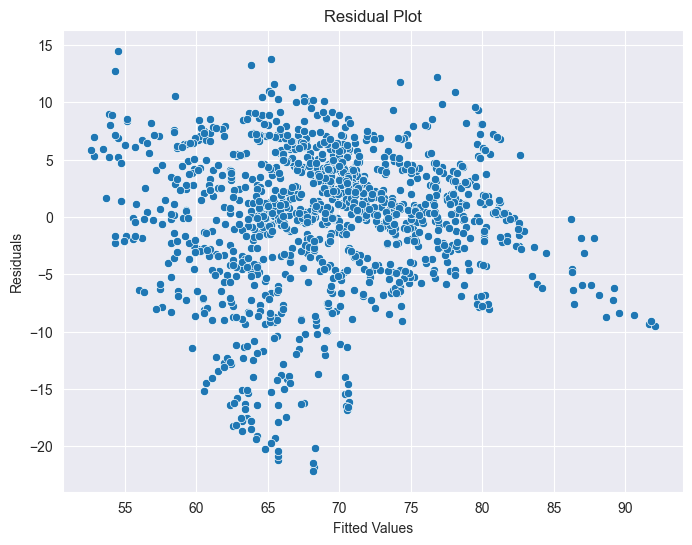

In [387]:
# Residual plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=model.fittedvalues, y=model.resid)
plt.title('Residual Plot')
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.show()

In [388]:
regression_model = LinearRegression()

In [389]:
# training the regression_model using training data set x_train and y_train
regression_model.fit(X_train, y_train) 

LinearRegression()

In [390]:
# regression model coefficient
regression_model.coef_

array([0.00000000e+00, 7.88943350e-05, 2.06238373e+00, 1.27827313e+00])

In [391]:
# y_intercept | bias
regression_model.intercept_

43.55436965931018

In [392]:
# making predictions using the test data set 
y_pred = regression_model.predict(X_test)

In [393]:
# creating the data set with actual y values and the predicted values
df_vs_predicted = pd.DataFrame({'Actual_y': y_test,'Predicted_y': y_pred})
df_vs_predicted

,Actual_y,Predicted_y
1210,67.5,66.387014
2273,73.8,71.827165
1005,79.1,81.351235
2926,54.9,64.450711
518,48.6,56.789125
...,...,...
1453,71.0,77.300713
2821,75.4,75.846156
483,55.9,65.102224
290,69.1,69.559014


Text(0, 0.5, 'Predicted_Y_values')

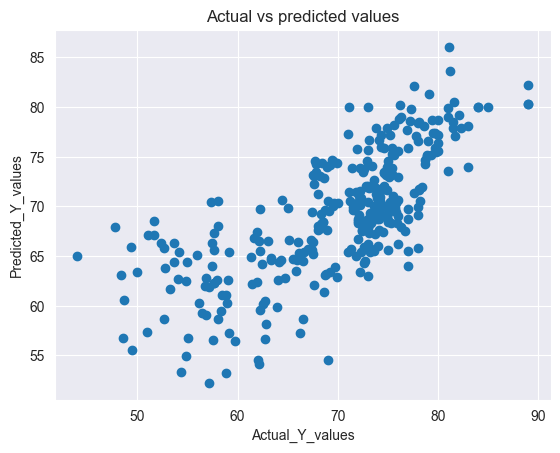

In [394]:
# plot actual and predicted values
plt.scatter(y_test, y_pred)
plt.title('Actual vs predicted values')
plt.xlabel('Actual_Y_values')
plt.ylabel('Predicted_Y_values')

getting the data for the train values y_test, y_pred

<Axes: xlabel='Schooling', ylabel='Life_expectancy'>

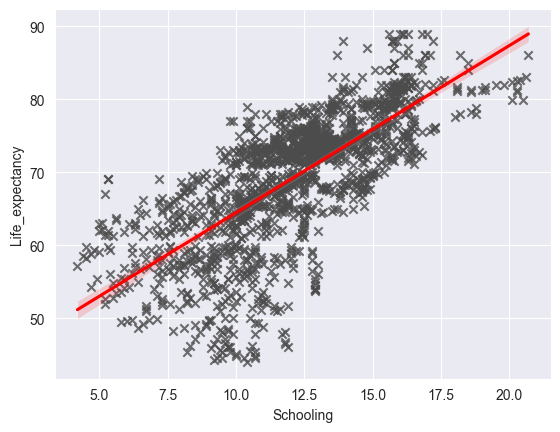

In [395]:
sns.regplot(data= df, x= df['Schooling'], y= y, ci= 99, marker= "x", color= ".3", line_kws= dict(color= "r"))

<Axes: xlabel='Income_composition_of_resources', ylabel='Life_expectancy'>

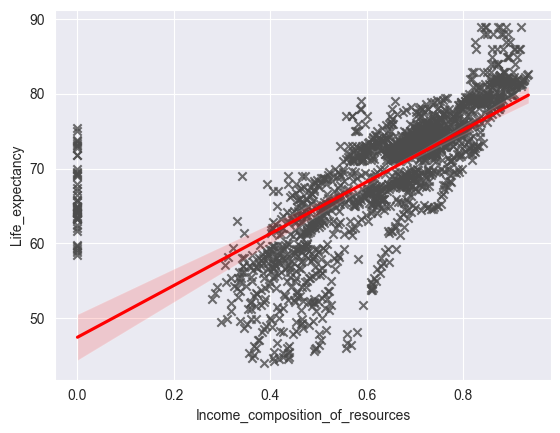

In [396]:
sns.regplot(data= df, x= df['Income_composition_of_resources'], y= y, ci= 99, marker= "x", color= ".3", line_kws= dict(color= "r"))

Income composition of resources:
Human Development Index in terms of income composition of resources (index ranging from 0 to 1)



<Axes: xlabel='BMI', ylabel='Life_expectancy'>

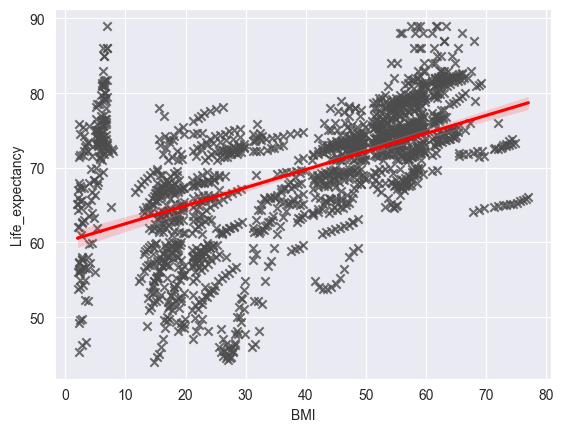

In [397]:
sns.regplot(data= df, x= df['BMI'], y= y, ci= 99, marker= "x", color= ".3", line_kws= dict(color= "r"))

Adult body mass index 
Found data about the levels of BMI and by looking at the sns.regplot BMI and Life expectancy

If your BMI is less than 18.5, it falls within the underweight range.
If your BMI is 18.5 to 24.9, it falls within the Healthy Weight range.
If your BMI is 25.0 to 29.9, it falls within the overweight range.
If your BMI is 30.0 or higher, it falls within the obese range.

There is some point in 70 plus BMI that is extreme obese range, and life expectancy is High and with extreme over weight will give health complications that would lower life expectancy, but the graph shows another data.


Centers for Disease Control and Prevention(CDC). Assessing Your Weight
https://www.cdc.gov/healthyweight/assessing/index.html#:~:text=If%20your%20BMI%20is%20less,falls%20within%20the%20overweight%20range.

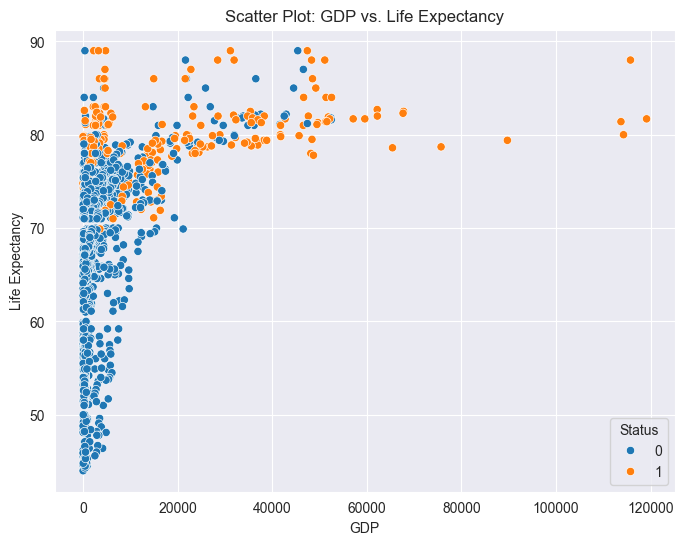

In [398]:
# Scatter plot of GDP vs. Life Expectancy
plt.figure(figsize=(8, 6))
sns.scatterplot(x='GDP', y='Life_expectancy', hue='Status', data=df)
plt.title('Scatter Plot: GDP vs. Life Expectancy')
plt.xlabel('GDP')
plt.ylabel('Life Expectancy')
plt.show()

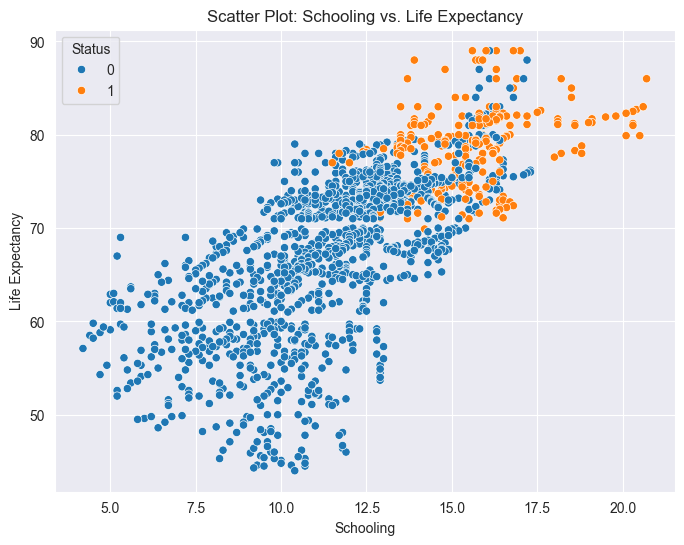

In [399]:
# Scatter plot of Schooling vs. Life Expectancy
plt.figure(figsize=(8, 6))
sns.scatterplot(x='Schooling', y='Life_expectancy', hue='Status', data=df)
plt.title('Scatter Plot: Schooling vs. Life Expectancy')
plt.xlabel('Schooling')
plt.ylabel('Life Expectancy')
plt.show()

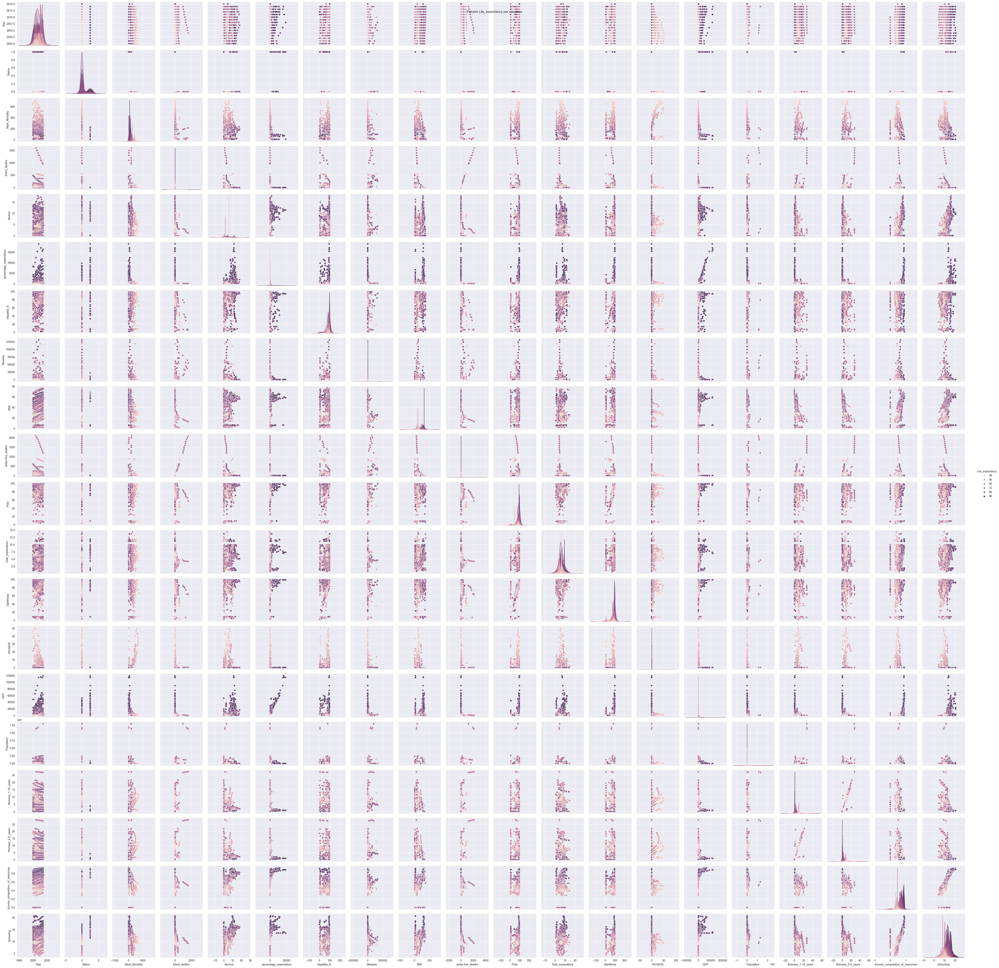

In [402]:
sns.pairplot (df, diag_kind='kde', kind='scatter', hue='Life_expectancy')
plt.suptitle ('Pairplot Life_expectancy per variables')
plt.show ()

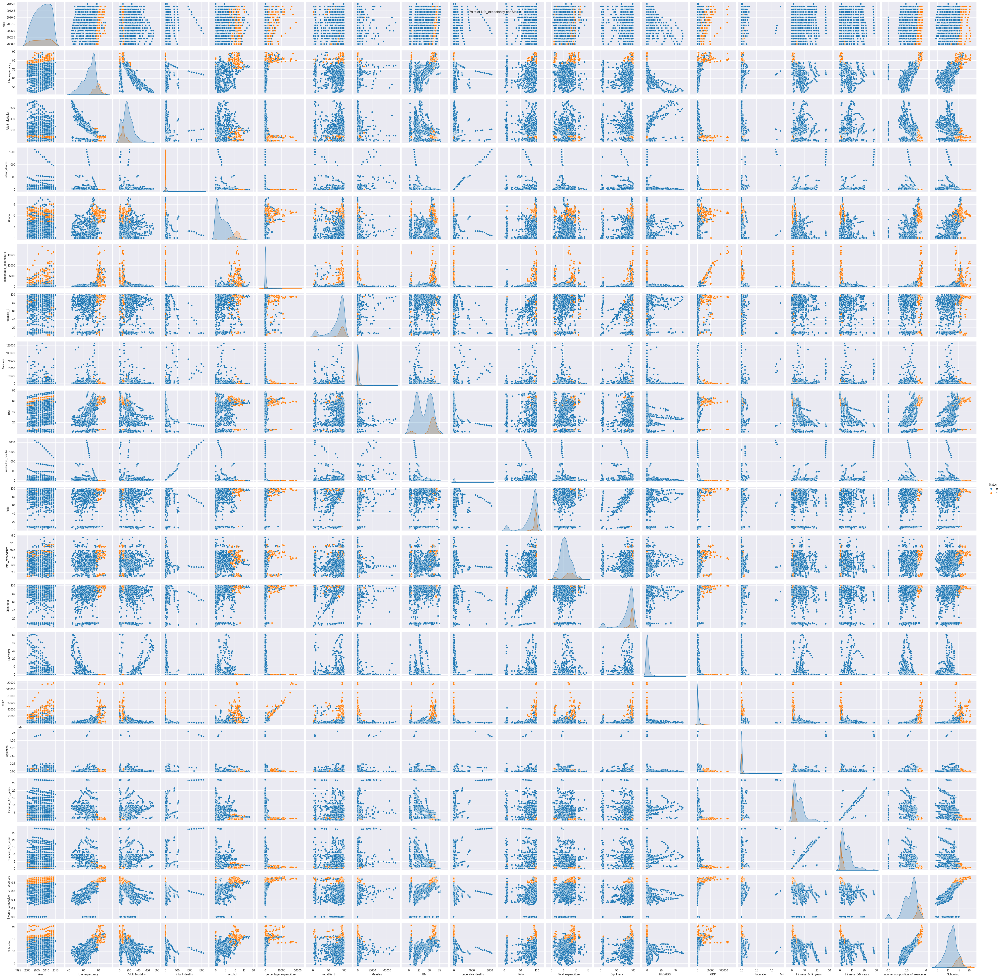

In [403]:
sns.pairplot (df, diag_kind='kde', kind='scatter', hue='Status')
plt.suptitle ('Pairplot Life_expectancy per Status')
plt.show ()